<b> DIP - Lab08 - Requirement </b> </br>
1. Kiếm 1 ảnh từ internet thực hiện các thao tác biến đổi sau bằng cách gọi hàm từ các thư viện (opencv hay skimage hay bất kỳ thư viện nào) 
* Scaling
* Rotation (30, 45, 60, 90, 120, 160, 180)
* Translation
* Shearing
2. Kiếm 1 ảnh từ internet thực hiện các thao tác biến đổi sau bằng cách nhân thông qua ma trận biến đổi  
* Scaling
* Rotation (30, 45, 60, 90, 120, 160, 180)
* Translation
* Shearing
3. Cũng thực hiện nhân ma trận. Tạo các ma trận tổng hợp sau: 
* Scaling 🡪 Rotation
* Rotation 🡪 Shearing 
* Scaling 🡪 Rotation 🡪 Shearing

4. Chụp một tấm ảnh bất kỳ từ điện thoại của bạn có chứa vật thể dạng hình chữ nhật hay hình vuông (ví dụ bức tranh, điện thoại, màn hình máy tính v.v…) (Lưu ý chụp nghiêng, xéo và không được chụp thẳng)
* Xác định 4 điểm góc của đối tượng bằng tay và vẽ chúng lên hình 
* Dùng biến đổi Affine hoặc Perspective để canh chỉnh chúng thẳng lại



In [2]:
# import thư viện
import numpy as np 
import pandas as pd
import cv2 
from matplotlib import pyplot as plt 
import matplotlib.cm as cm
import matplotlib.gridspec as gridspec
from pylab import imread
from skimage.color import rgb2gray

In [3]:
def ShowImage(ImageList, nRows = 1, nCols = 2, WidthSpace = 0.00, HeightSpace = 0.00):
    from matplotlib import pyplot as plt 
    import matplotlib.gridspec as gridspec
    
    gs = gridspec.GridSpec(nRows, nCols)     
    gs.update(wspace=WidthSpace, hspace=HeightSpace) # set the spacing between axes.
    plt.figure(figsize=(20,10))
    for i in range(len(ImageList)):
        ax1 = plt.subplot(gs[i])
        ax1.set_xticklabels([])
        ax1.set_yticklabels([])
        ax1.set_aspect('equal')

        plt.subplot(nRows, nCols,i+1)

        image = ImageList[i].copy()
        if (len(image.shape) < 3):
            plt.imshow(image, plt.cm.gray)
        else:
            plt.imshow(image)
        plt.title("Image " + str(i))
        plt.axis('off')

    plt.show()

In [3]:
def InfoImage(IM):
    Image = IM
    Width = Image.shape[1]
    Height = Image.shape[0]
    Channel = len(Image.shape)
    print("Width : ", Width, " Height : ", Height, " Channel : ", Channel)
    
    if(Channel == 2):
        print("Min Intensity: ", IM.min(), " Max Intensity: ", IM.max())
    else:
        print("Red - Min Intensity: ", IM[:,:,0].min(), " Max Intensity: ", IM[:,:,0].max())
        print("Green - Min Intensity: ", IM[:,:,1].min(), " Max Intensity: ", IM[:,:,1].max())
        print("Blue - Min Intensity: ", IM[:,:,2].min(), " Max Intensity: ", IM[:,:,2].max()) 

In [4]:
def ResizeImage(IM, DesiredWidth, DesiredHeight):
    from skimage.transform import rescale, resize
    
    OrigWidth = float(IM.shape[1])
    OrigHeight = float(IM.shape[0])
    Width = DesiredWidth 
    Height = DesiredHeight

    if((Width == 0) & (Height == 0)):
        return IM
    
    if(Width == 0):
        Width = int((OrigWidth * Height)/OrigHeight)

    if(Height == 0):
        Height = int((OrigHeight * Width)/OrigWidth)

    dim = (Width, Height)
#     print(dim)
    resizedIM = cv2.resize(IM, dim, interpolation = cv2.INTER_NEAREST) 
#     imshows([IM, resizedIM], ["Image", "resizedIM"],1,2)
    return resizedIM

#### Câu 1: 

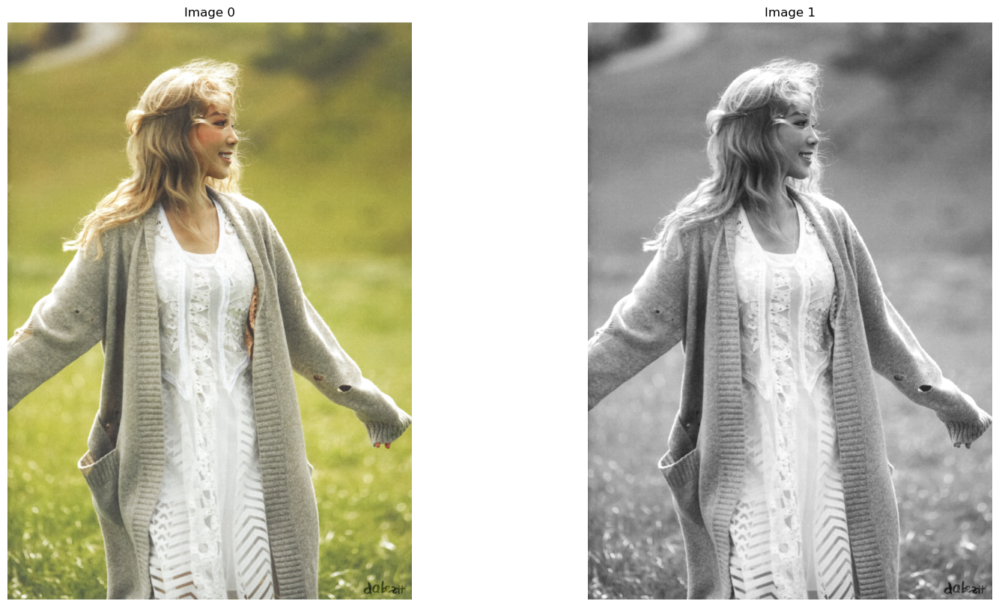

In [5]:
# Read Image 
image_color_1 = imread("1.jpg")
# Convert Image into Gray
image_gray_1 = cv2.cvtColor(image_color_1, cv2.COLOR_RGB2GRAY)

# Display Image
ShowImage([image_color_1, image_gray_1], 1, 2)


 image_color :
Width :  3344  Height :  4776  Channel :  3
Red - Min Intensity:  20  Max Intensity:  255
Green - Min Intensity:  26  Max Intensity:  255
Blue - Min Intensity:  0  Max Intensity:  255

 image_scale01 :
Width :  1672  Height :  4776  Channel :  3
Red - Min Intensity:  19  Max Intensity:  255
Green - Min Intensity:  25  Max Intensity:  255
Blue - Min Intensity:  0  Max Intensity:  255

 image_scale02 :
Width :  1672  Height :  2388  Channel :  3
Red - Min Intensity:  24  Max Intensity:  255
Green - Min Intensity:  27  Max Intensity:  255
Blue - Min Intensity:  0  Max Intensity:  255

 image_scale03 :
Width :  3344  Height :  2388  Channel :  3
Red - Min Intensity:  24  Max Intensity:  255
Green - Min Intensity:  27  Max Intensity:  255
Blue - Min Intensity:  0  Max Intensity:  255


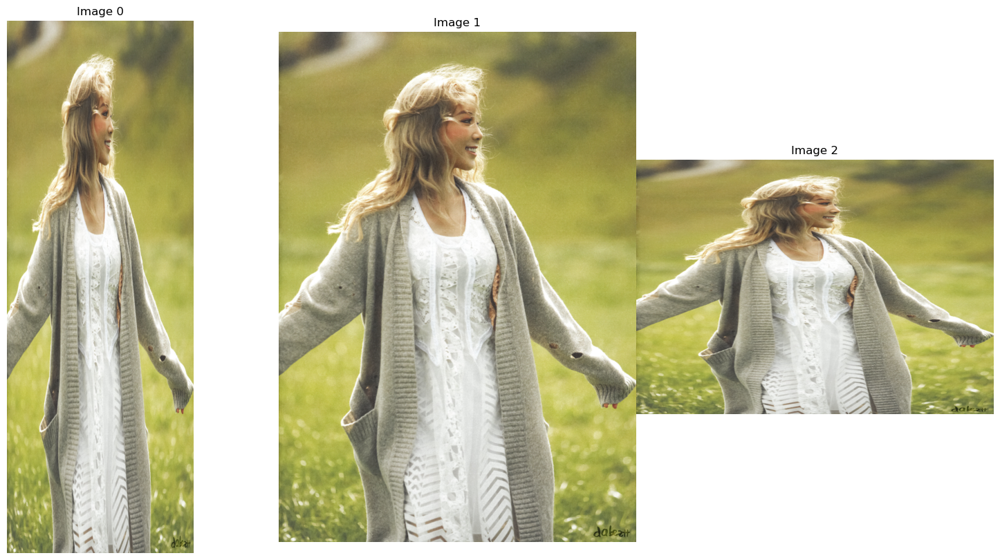

In [11]:
# Scaling
image_scale01 = cv2.resize(image_color_1,None,fx=0.5, fy=1, interpolation = cv2.INTER_CUBIC)
image_scale02 = cv2.resize(image_color_1,None,fx=0.5, fy=0.5, interpolation = cv2.INTER_CUBIC)
image_scale03 = cv2.resize(image_color_1,None,fx=1, fy=0.5, interpolation = cv2.INTER_CUBIC)

print("\n image_color :")
InfoImage(image_color_1)
print("\n image_scale01 :")
InfoImage(image_scale01)
print("\n image_scale02 :")
InfoImage(image_scale02)
print("\n image_scale03 :")
InfoImage(image_scale03)

ShowImage([image_scale01, image_scale02, image_scale03], 1, 3)

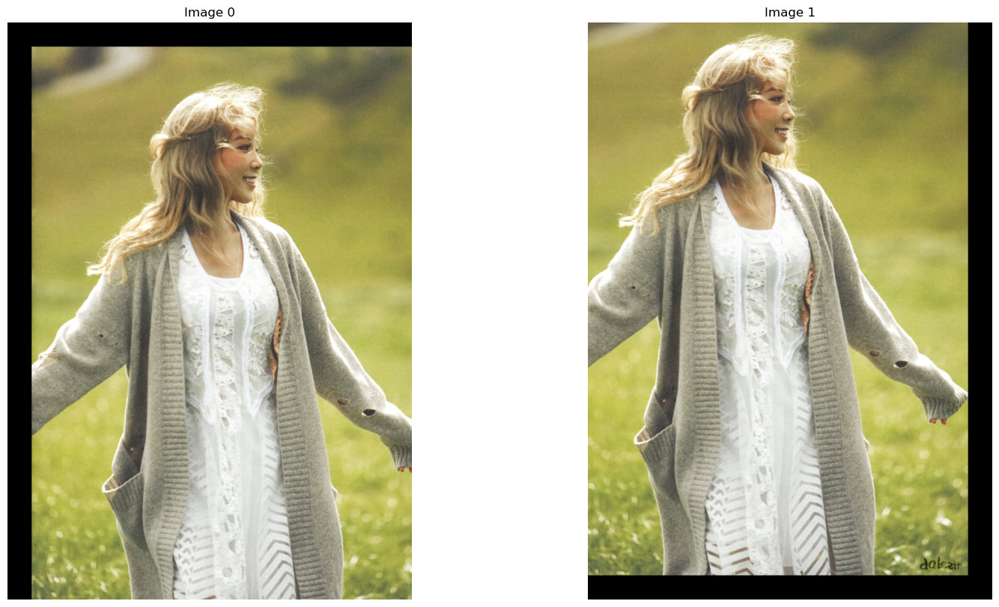

In [14]:
ShowImage([image_translation03, image_translation04], 1, 2)

In [19]:
# Rotation (30, 45, 60, 90, 120, 160, 180)
rows,cols  = image_color_1.shape[:2]
RotationMatrix = cv2.getRotationMatrix2D((cols/2,rows/2),30,1)
image_rotation01 = cv2.warpAffine(image_color_1,RotationMatrix,(cols,rows))

RotationMatrix = cv2.getRotationMatrix2D((cols/2,rows/2),45,1)
image_rotation02 = cv2.warpAffine(image_color_1,RotationMatrix,(cols,rows))

RotationMatrix = cv2.getRotationMatrix2D((cols/2,rows/2),60,1)
image_rotation03 = cv2.warpAffine(image_color_1,RotationMatrix,(cols,rows))

RotationMatrix = cv2.getRotationMatrix2D((cols/2,rows/2),90,1)
image_rotation04 = cv2.warpAffine(image_color_1,RotationMatrix,(cols,rows))

RotationMatrix = cv2.getRotationMatrix2D((cols/2,rows/2),120,1)
image_rotation05 = cv2.warpAffine(image_color_1,RotationMatrix,(cols,rows))

RotationMatrix = cv2.getRotationMatrix2D((cols/2,rows/2),160,1)
image_rotation06 = cv2.warpAffine(image_color_1,RotationMatrix,(cols,rows))

RotationMatrix = cv2.getRotationMatrix2D((cols/2,rows/2),180,1)
image_rotation07 = cv2.warpAffine(image_color_1,RotationMatrix,(cols,rows))

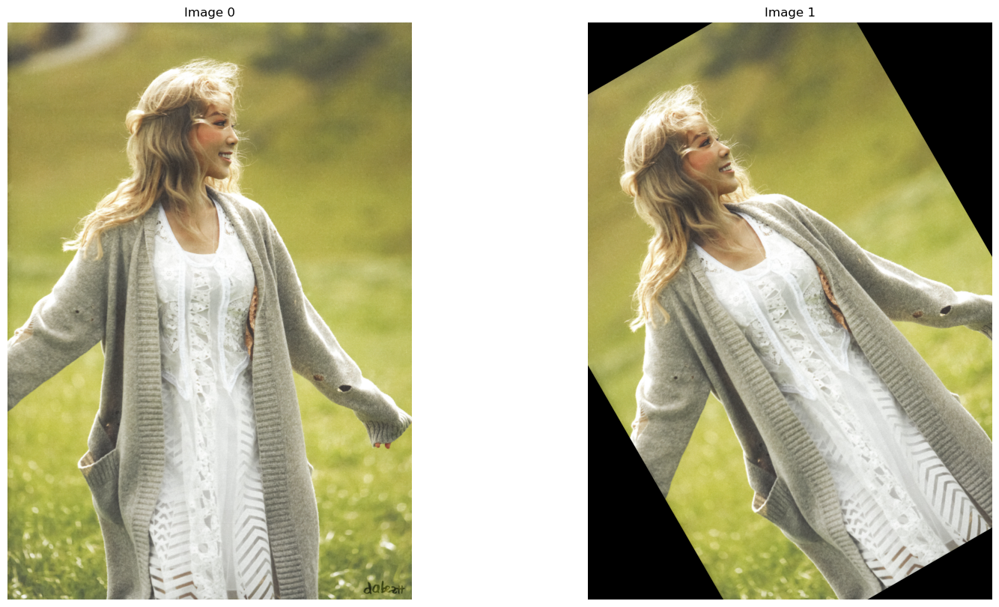

In [20]:
ShowImage([image_color_1, image_rotation01], 1, 2)

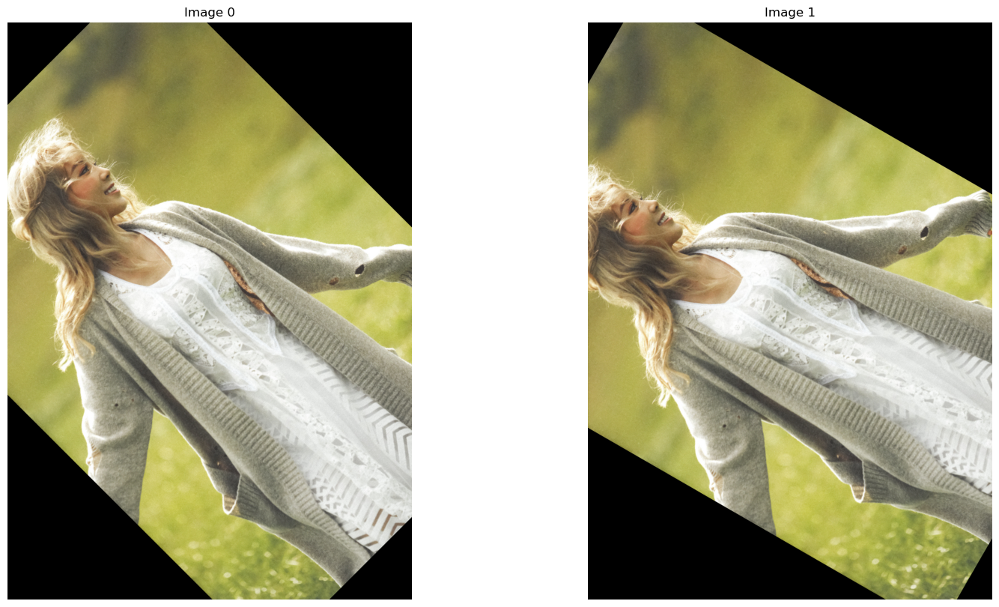

In [21]:
ShowImage([image_rotation02, image_rotation03], 1, 2)

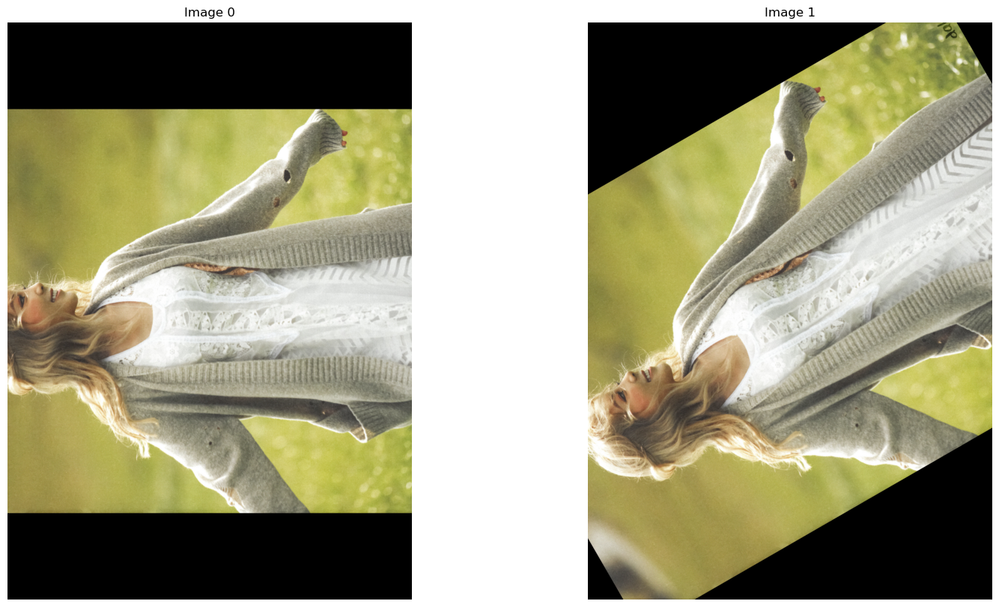

In [22]:
ShowImage([image_rotation04, image_rotation05], 1, 2)

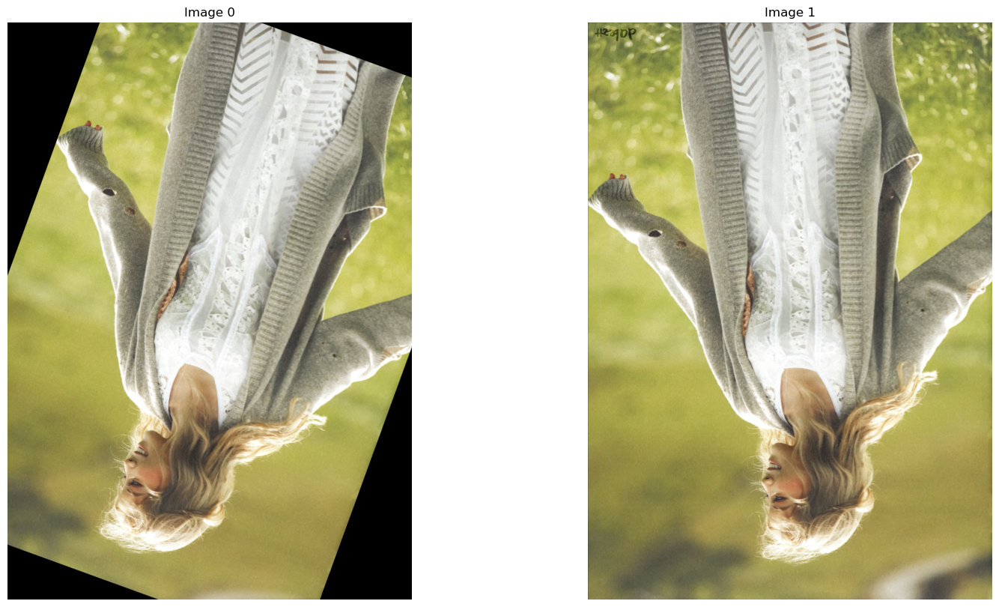

In [23]:
ShowImage([image_rotation06, image_rotation07], 1, 2)

In [12]:
# Translation
rows,cols  = image_color_1.shape[:2]

TranslationMatrix = np.float32([[1,0,200],[0,1,0]])
image_translation01 = cv2.warpAffine(image_color_1,TranslationMatrix,(cols,rows))

TranslationMatrix = np.float32([[1,0,0],[0,1,200]])
image_translation02 = cv2.warpAffine(image_color_1,TranslationMatrix,(cols,rows))

TranslationMatrix = np.float32([[1,0,200],[0,1,200]])
image_translation03 = cv2.warpAffine(image_color_1,TranslationMatrix,(cols,rows))

TranslationMatrix = np.float32([[1,0,-200],[0,1,-200]])
image_translation04 = cv2.warpAffine(image_color_1,TranslationMatrix,(cols,rows))

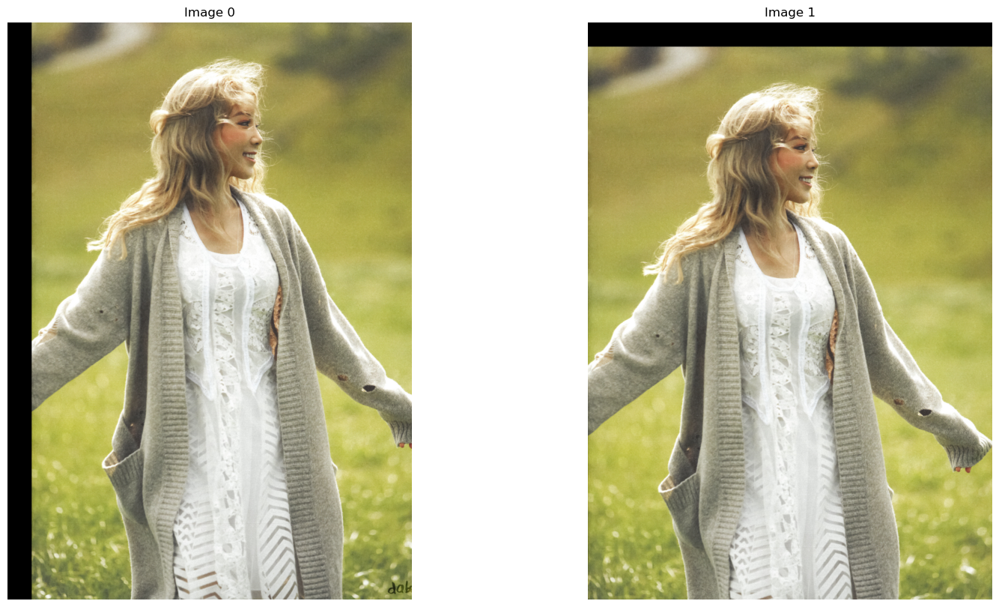

In [16]:
ShowImage([image_translation01, image_translation02], 1, 2)

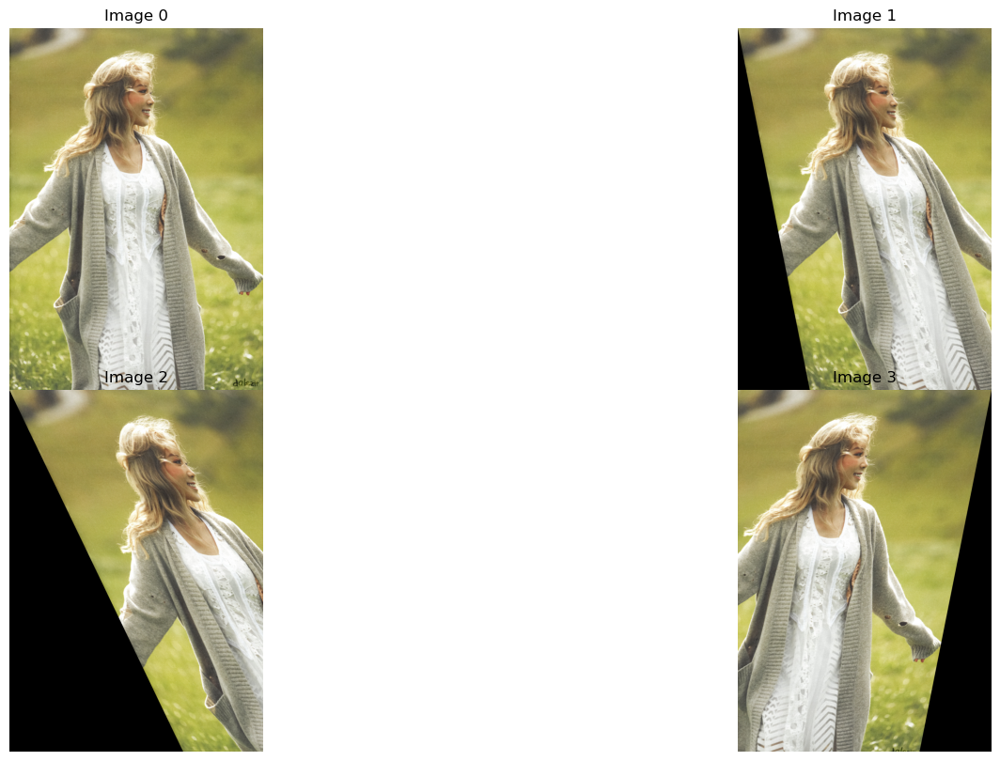

In [24]:
# Shearing
from skimage import transform as tf

# Create Afine transform
afine_tf = tf.AffineTransform(shear=0.2)
image_shear01 = tf.warp(image_color_1, inverse_map=afine_tf)

afine_tf = tf.AffineTransform(shear=0.5)
image_shear02 = tf.warp(image_color_1, inverse_map=afine_tf)

afine_tf = tf.AffineTransform(shear=-0.2)
image_shear03 = tf.warp(image_color_1, inverse_map=afine_tf)

ShowImage([image_color_1, image_shear01, image_shear02, image_shear03], 2, 2)

#### Câu 2:

Width :  3344  Height :  4800  Channel :  3
Red - Min Intensity:  3  Max Intensity:  255
Green - Min Intensity:  1  Max Intensity:  255
Blue - Min Intensity:  2  Max Intensity:  255


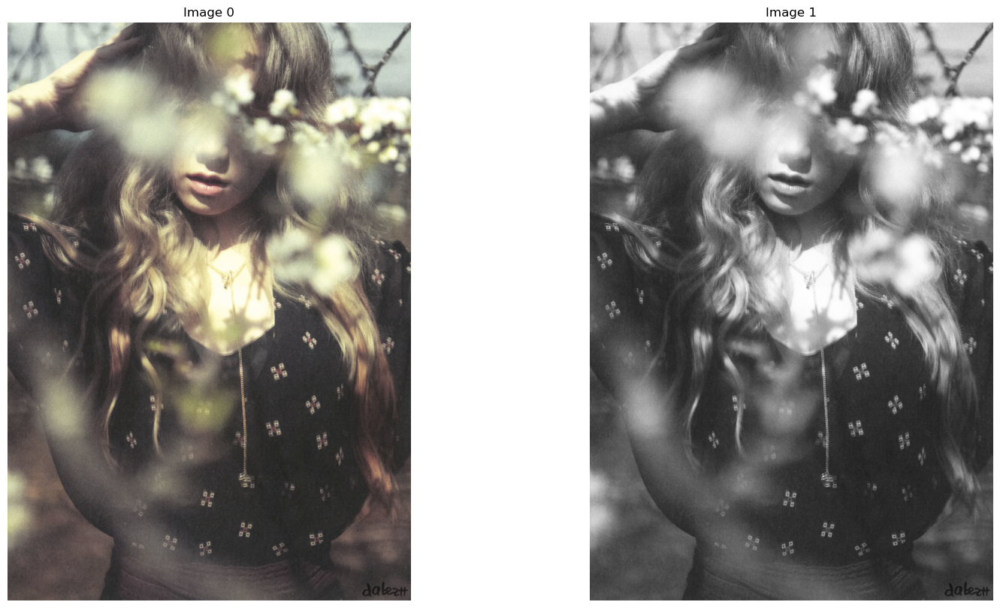

In [6]:
# Read Image 
image_color_2 = imread("2.jpg")
# Convert Image into Gray
image_gray_2 = cv2.cvtColor(image_color_2, cv2.COLOR_RGB2GRAY)

# Display Image
InfoImage(image_color_2)
ShowImage([image_color_2, image_gray_2], 1, 2)

Matrix : 


array([[  1.26666667,   0.6       , -83.33333333],
       [ -0.33333333,   1.        ,  66.66666667]])

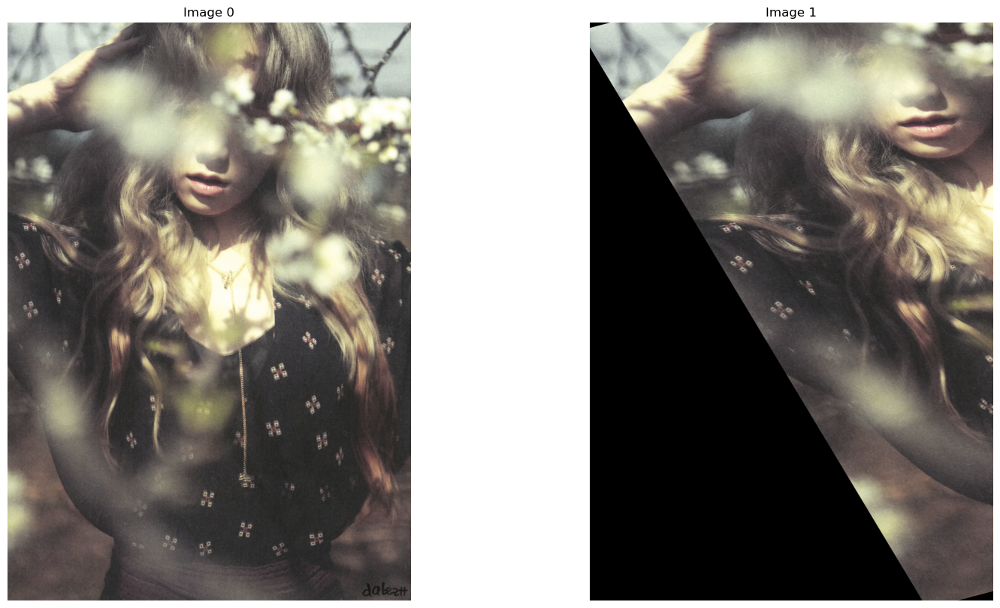

In [7]:
rows,cols  = image_color_2.shape[:2]

PointList_From = [[50,50],[200,50],[50,200]]
PointList_To = [[10,100],[200,50],[100,250]]

pts1 = np.float32(PointList_From)
pts2 = np.float32(PointList_To)

MappingMatrix = cv2.getAffineTransform(pts1,pts2)
image_Affine = cv2.warpAffine(image_color_2,MappingMatrix,(cols,rows))

print("Matrix : ")
display(MappingMatrix)
ShowImage([image_color_2, image_Affine], 1, 2)

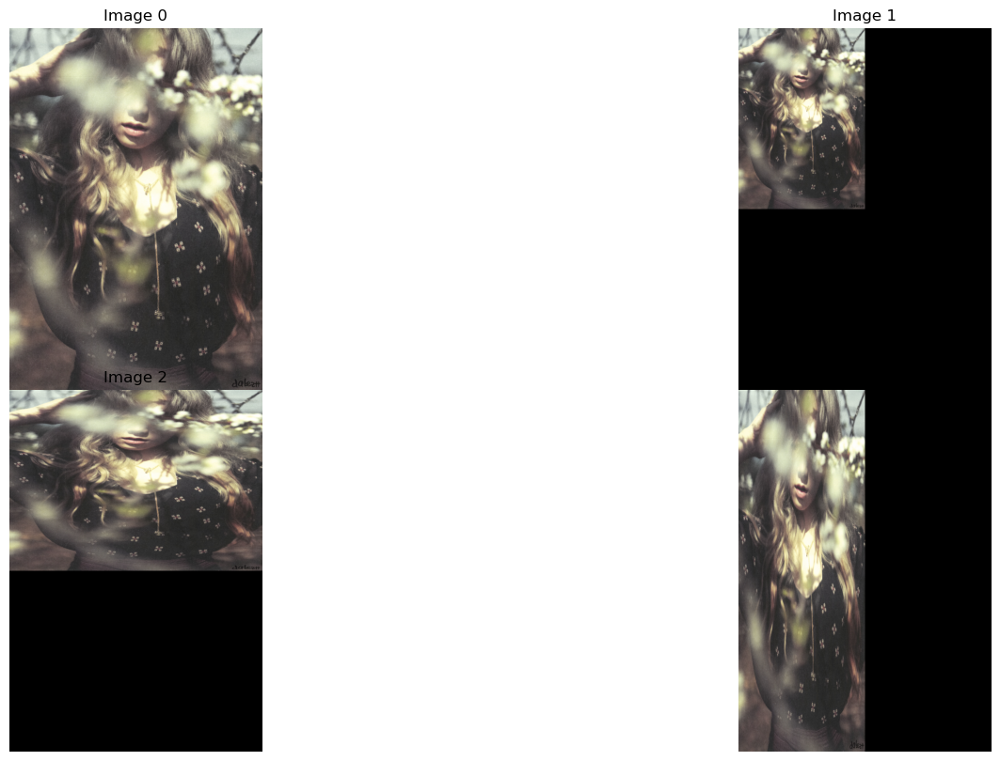

In [15]:
# Scaling
def scaling_matrix(sx, sy):
    return np.array([[sx, 0, 0], [0, sy, 0], [0, 0, 1]])

scale_matrix_1 = scaling_matrix(0.5, 0.5)
scale_matrix_2 = scaling_matrix(1, 0.5)
scale_matrix_3 = scaling_matrix(0.5, 1)
scaled_01 = cv2.warpAffine(image_color_2, scale_matrix_1[:2, :], (image_color_2.shape[1], image_color_2.shape[0]))
scaled_02 = cv2.warpAffine(image_color_2, scale_matrix_2[:2, :], (image_color_2.shape[1], image_color_2.shape[0]))
scaled_03 = cv2.warpAffine(image_color_2, scale_matrix_3[:2, :], (image_color_2.shape[1], image_color_2.shape[0]))
ShowImage([image_color_2, scaled_01, scaled_02, scaled_03], 2, 2)

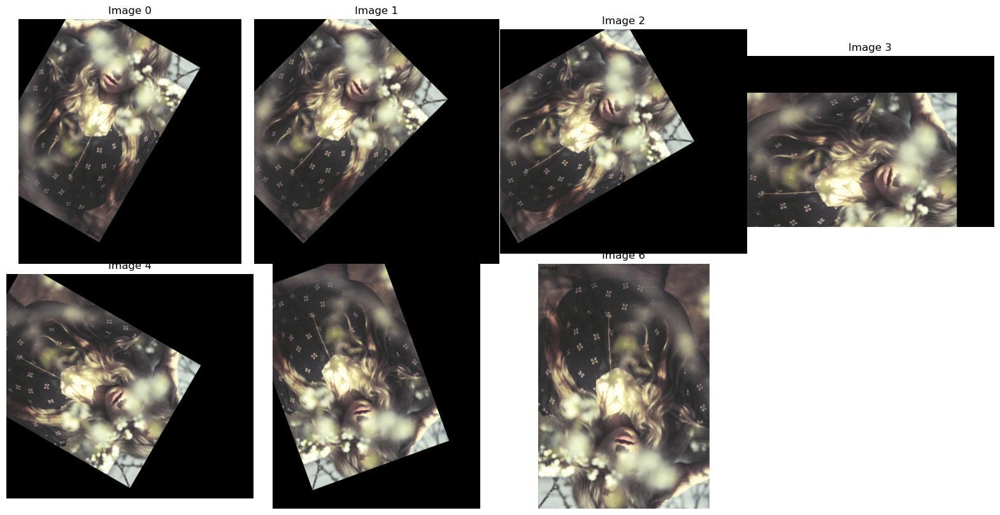

In [14]:
# Rotation (30, 45, 60, 90, 120, 160, 180)
def rotate_image(image, angle):
    height, width = image.shape[:2]
    # Tính toán tâm xoay
    center_x, center_y = width / 2, height / 2
    
    theta = np.radians(angle)
    cos_theta = np.cos(theta)
    sin_theta = np.sin(theta)

    # Tính toán kích thước mới của ảnh sau khi xoay
    new_width = int((height * np.abs(sin_theta)) + (width * np.abs(cos_theta)))
    new_height = int((height * np.abs(cos_theta)) + (width * np.abs(sin_theta)))

    # Tính ma trận biến đổi để xoay ảnh
    rotation_matrix = np.array([
        [cos_theta, -sin_theta, (1 - cos_theta) * center_x + sin_theta * center_y],
        [sin_theta, cos_theta, -sin_theta * center_x + (1 - cos_theta) * center_y],
        [0, 0, 1]
    ])

    rotated_image = cv2.warpAffine(image, rotation_matrix[:2, :], (new_width, new_height), flags=cv2.INTER_LINEAR)
    return rotated_image

angle_list = [30, 45, 60, 90, 120, 160, 180]

rotated_images = []
for angle in angle_list:
    rotated_img = rotate_image(image_color_2, angle)
    rotated_images.append(rotated_img)

ShowImage(rotated_images, nRows=2, nCols=4)

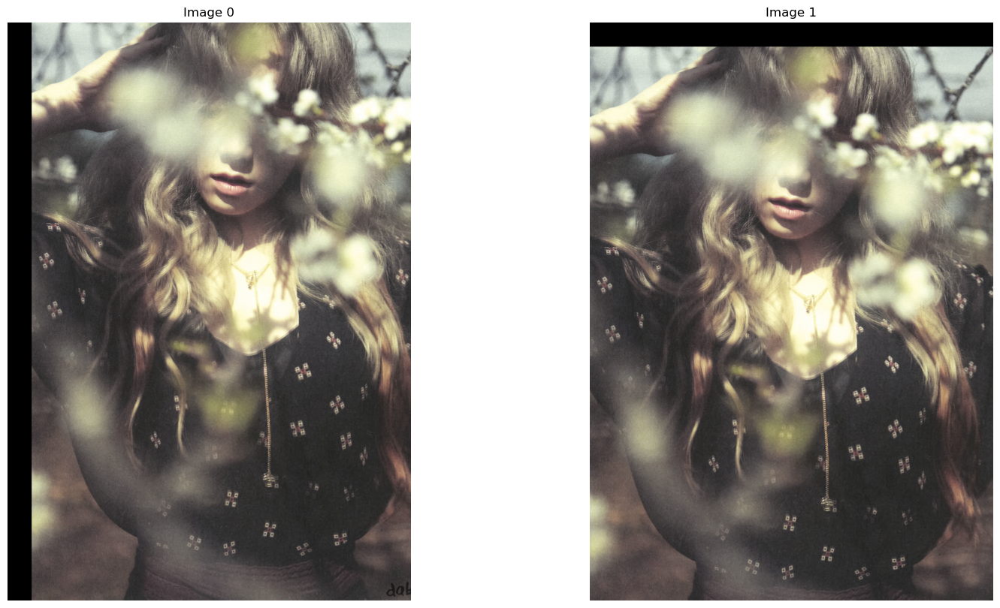

In [20]:
# Translation
def translation_matrix(tx, ty):
    return np.array([[1, 0, tx], [0, 1, ty], [0, 0, 1]])
rows, cols = image_color_2.shape[:2]

translation_01 = translation_matrix(200, 0).astype(np.float32)[:2, :]
translation_02 = translation_matrix(0, 200).astype(np.float32)[:2, :]

translated_img_01 = cv2.warpAffine(image_color_2, translation_01[:2, :], (cols, rows))
translated_img_02 = cv2.warpAffine(image_color_2, translation_02[:2, :], (cols, rows))

ShowImage([translated_img_01, translated_img_02], 1, 2)

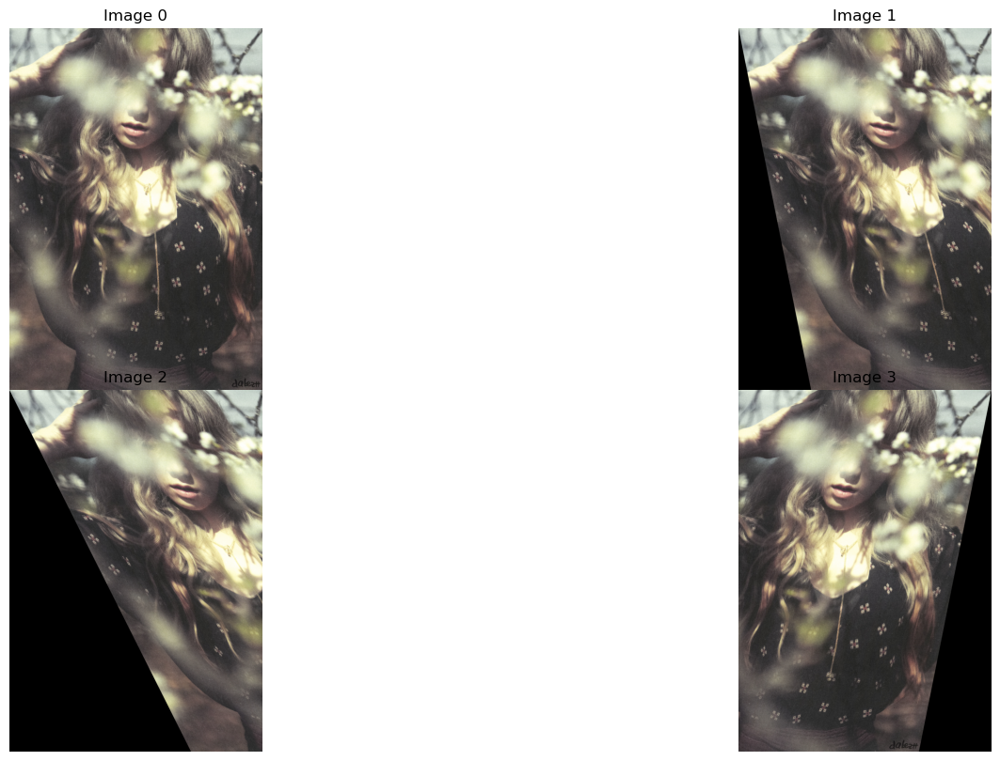

In [22]:
# Shearing
def shearing_matrix(shx, shy):
    return np.array([[1, shx, 0], [shy, 1, 0], [0, 0, 1]])

rows, cols = image_color_2.shape[:2]

shearing_01 = shearing_matrix(0.2, 0)  
shearing_02 = shearing_matrix(0.5, 0)  
shearing_03 = shearing_matrix(-0.2, 0)  

sheared_img_01 = cv2.warpAffine(image_color_2, shearing_01[:2, :], (cols, rows))
sheared_img_02 = cv2.warpAffine(image_color_2, shearing_02[:2, :], (cols, rows))
sheared_img_03 = cv2.warpAffine(image_color_2, shearing_03[:2, :], (cols, rows))

ShowImage([image_color_2, sheared_img_01, sheared_img_02, sheared_img_03], 2, 2)

#### Câu 3:

Width :  3336  Height :  4784  Channel :  3
Red - Min Intensity:  17  Max Intensity:  255
Green - Min Intensity:  18  Max Intensity:  255
Blue - Min Intensity:  17  Max Intensity:  255


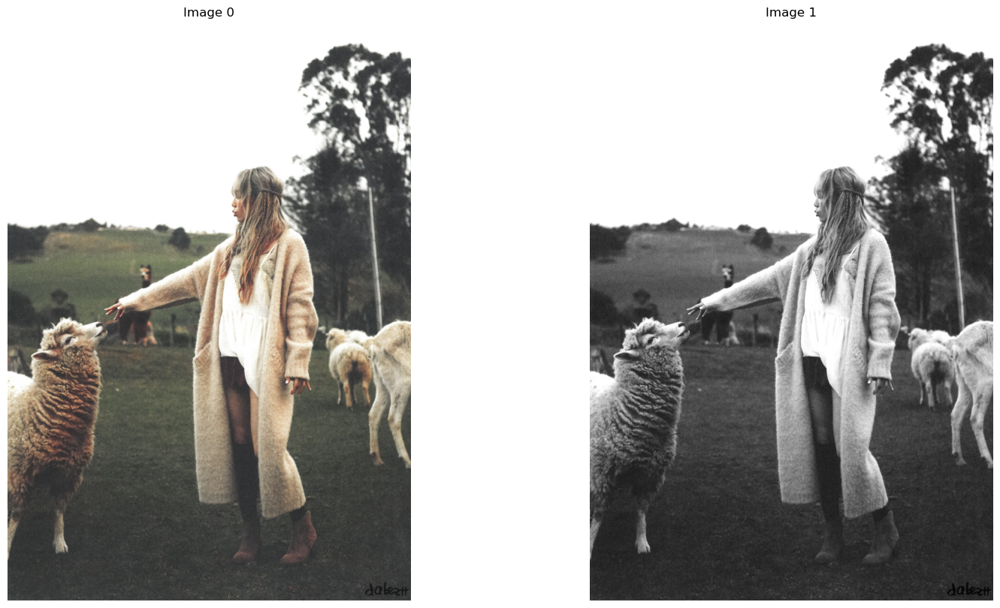

In [23]:
# Read Image 
image_color_3 = imread("3.jpg")
# Convert Image into Gray
image_gray_3 = cv2.cvtColor(image_color_3, cv2.COLOR_RGB2GRAY)

# Display Image
InfoImage(image_color_3)
ShowImage([image_color_3, image_gray_3], 1, 2)

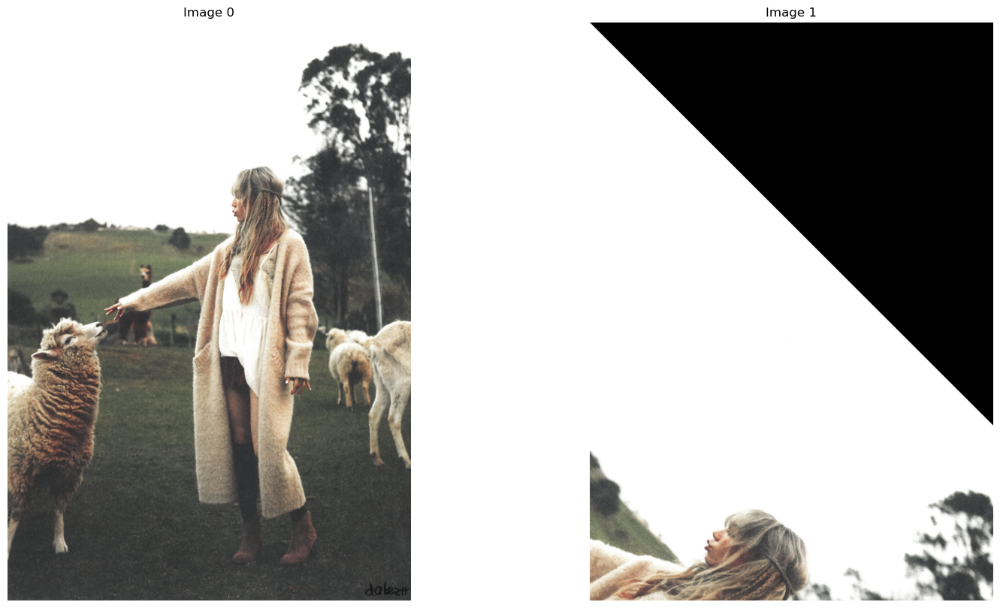

In [26]:
# Scaling 🡪 Rotation

rows, cols = image_color_3.shape[:2]

def scaling_matrix(sx, sy):
    return np.array([[sx, 0, 0], [0, sy, 0], [0, 0, 1]])

def rotation_matrix(angle):
    theta = np.radians(angle)
    cos_theta = np.cos(theta)
    sin_theta = np.sin(theta)
    return np.array([[cos_theta, -sin_theta, 0], [sin_theta, cos_theta, 0], [0, 0, 1]])

# Scaling
scaling_x = 2
scaling_y = 1.5
scaling = scaling_matrix(scaling_x, scaling_y)

# Rotation
angle = 45 
rotation = rotation_matrix(angle)

# Nhân ma trận scaling với ma trận rotation để tạo ma trận tổng hợp
scaling_then_rotation = np.dot(rotation, scaling)

transformed_01 = cv2.warpAffine(image_color_3, scaling_then_rotation[:2, :], (cols, rows))
ShowImage([image_color_3, transformed_01], 1, 2)

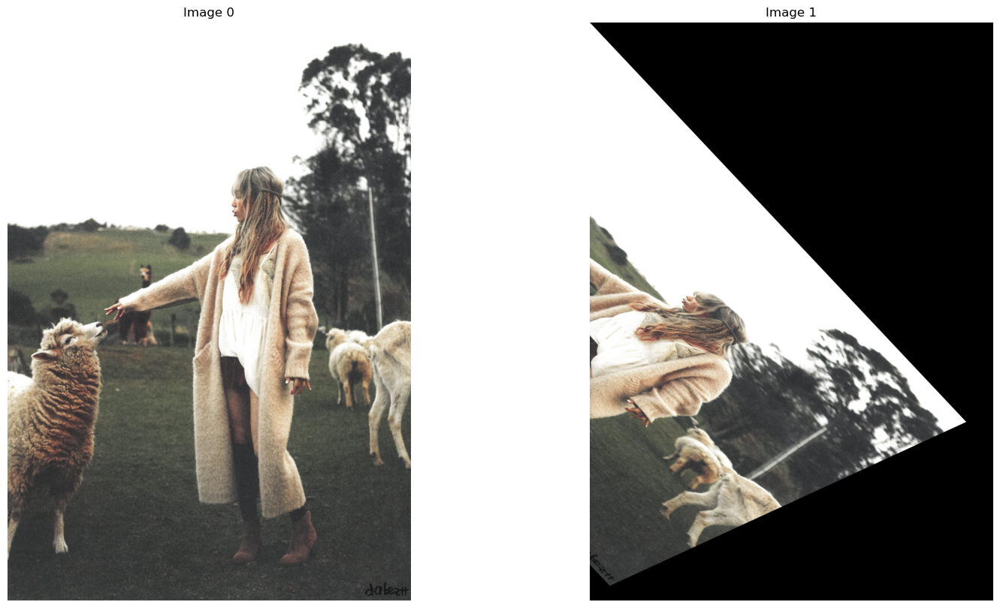

In [28]:
# Rotation 🡪 Shearing

def shearing_matrix(shx, shy):
    return np.array([[1, shx, 0], [shy, 1, 0], [0, 0, 1]])

# Rotation
angle = 60 
rotation = rotation_matrix(angle)

# Shearing
shearing_x = 0.5
shearing_y = 0.25
shearing = shearing_matrix(shearing_x, shearing_y)

# Nhân ma trận rotation với ma trận shearing để tạo ma trận tổng hợp
rotation_then_shearing = np.dot(shearing, rotation)

transformed_02 = cv2.warpAffine(image_color_3, rotation_then_shearing[:2, :], (cols, rows))
ShowImage([image_color_3, transformed_02], 1, 2)

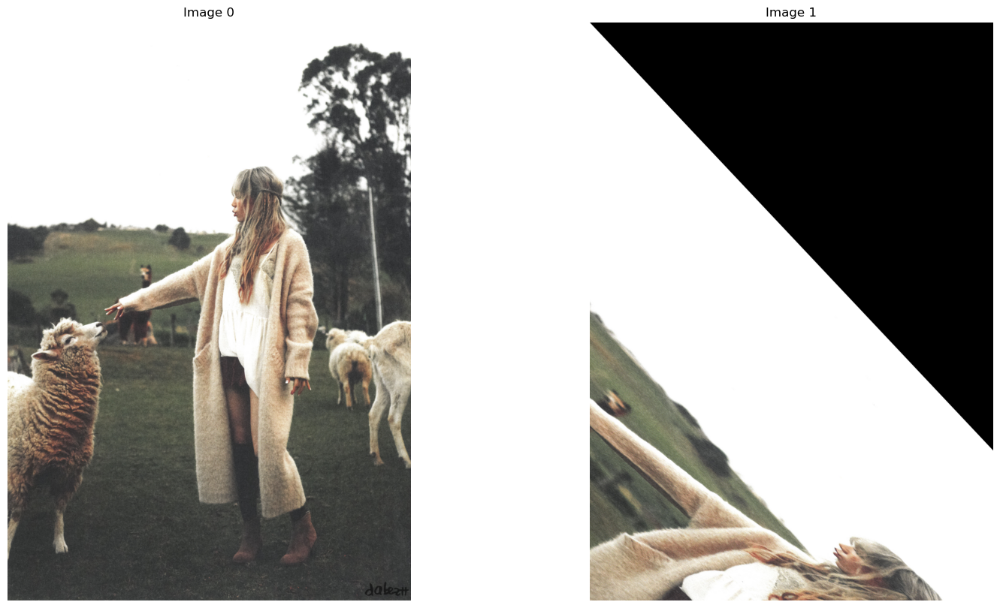

In [29]:
# Scaling 🡪 Rotation 🡪 Shearing

# Nhân ma trận scaling với ma trận rotation rồi nhân với ma trận shearing
scaling_rotation_shearing = np.dot(rotation_then_shearing, scaling)

transformed_03 = cv2.warpAffine(image_color_3, scaling_rotation_shearing[:2, :], (cols, rows))
ShowImage([image_color_3, transformed_03], 1, 2)

#### Câu 4:

Width :  1536  Height :  2048  Channel :  3
Red - Min Intensity:  0  Max Intensity:  255
Green - Min Intensity:  0  Max Intensity:  255
Blue - Min Intensity:  0  Max Intensity:  255


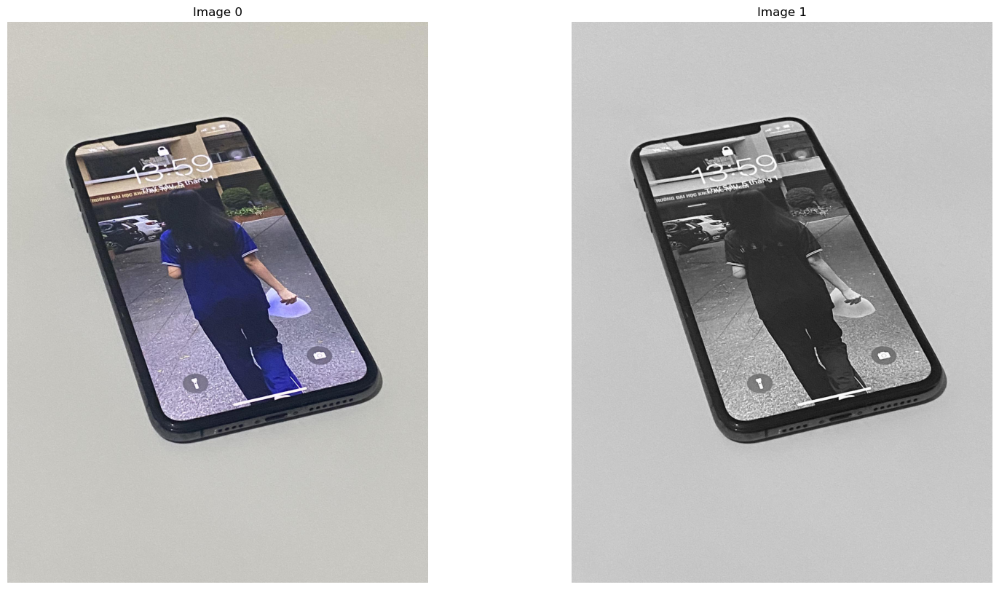

In [5]:
# Read Image 
image_color_4 = imread("4.jpg")
# Convert Image into Gray
image_gray_4 = cv2.cvtColor(image_color_4, cv2.COLOR_RGB2GRAY)

# Display Image
InfoImage(image_color_4)
ShowImage([image_color_4, image_gray_4], 1, 2)

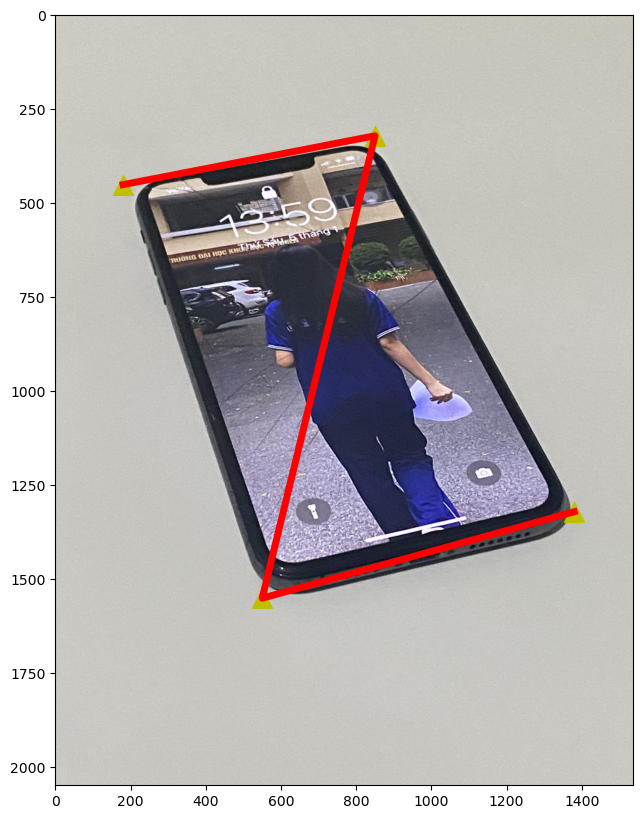

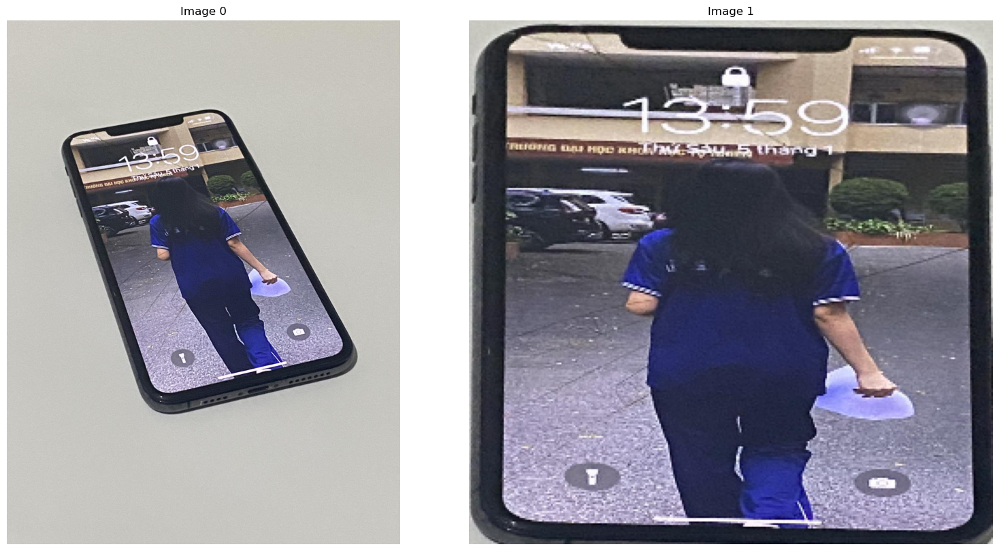

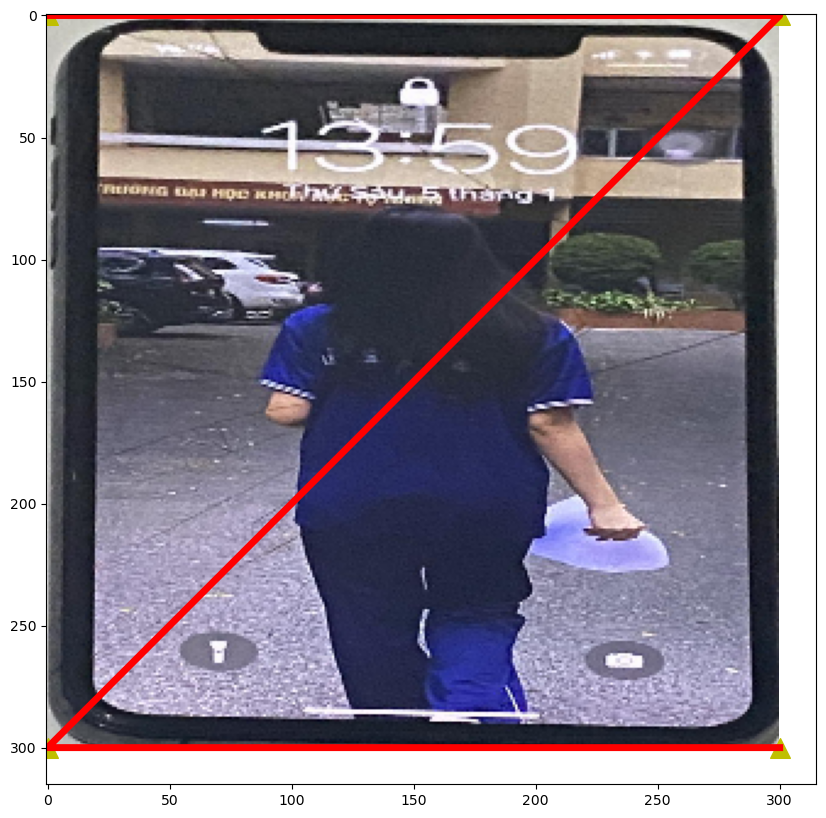

In [10]:
## Xác định 4 điểm góc của đối tượng bằng tay và vẽ chúng lên hình
rows,cols,ch = image_color_4.shape

PointList_From = [[180,450],[850,320],[550,1550],[1380,1320]]
PointList_To = [[0,0],[300,0],[0,300],[300,300]]

XList = []
YList = []

for pt in PointList_From:
    XList.append(pt[0])
    YList.append(pt[1])
    
plt.figure(figsize=(10,10))
plt.imshow(image_color_4)

plt.scatter(XList, YList, c='y', s=200, marker='^')
plt.plot(XList,YList,'r', linewidth=5, markersize=12)

plt.show()


pts1 = np.float32(PointList_From)
pts2 = np.float32(PointList_To)
MappingMatrix = cv2.getPerspectiveTransform(pts1,pts2)
image_Perspective = cv2.warpPerspective(image_color_4,MappingMatrix,(300,300))
ShowImage([image_color_4, image_Perspective], 1, 2)

XList = []
YList = []

for pt in PointList_To:
    XList.append(pt[0])
    YList.append(pt[1])
    
plt.figure(figsize=(10,10))
plt.imshow(image_Perspective)

plt.scatter(XList, YList, c='y', s=200, marker='^')
plt.plot(XList,YList,'r', linewidth=5, markersize=12)

plt.show()
